# Exploring the Food Culture in Melbourne using Foursquare API and K-Means Clustering

<h2> Introduction </h2>

<h3>Background </h3>
    Melbourne is known as the food capital of Australia.  It is considered to be a multicultural melting pot as it is a home to more than 200 
    nationalities, hence similar number of cuisine inspirations. Quoting from an article on the food culture  of Melbourne: 

   <i>“There is no authentic Melbourne dish or cuisine. Rather, the city's food options are limitless because it is a multicultural melting pot. Food is a portal into culture, and Melbourne's vibrant immigration history remains at the forefront of its culture partly because of its undeniably international cuisine.”</i>


<h3>Problem</h3>
	While on one hand having a plethora of food options is advantageous in an ethnically 
	diverse city, however on the other hand exploring a wide array of food places might be
	equally time consuming for someone not so well verse with the city. Moreover, there is a 
	fierce competition among the eateries to attract the foodies in the city, and hence new 
	eateries keep popping on and off on Melbourne’s radar. 

  The aim of this project is to explore the food preferences/taste of various suburbs in 
	Melbourne by segmenting eateries in various suburbs based on the cuisines which they 
	offer. In this project, the Foursquare’s ‘Places API’ will be utilised to fetch venues in 
	Each sub-urban location and further ‘K-Means’ algorithm will be used to segment these 
	venues into clusters of similar cuisines. Moreover, a profile for each suburb location will 
	be prepared describing the most common type of eateries using Exploratory Data
	Analysis (EDA), which would help to discover further about the culture and diversity of 
	the neighborhood.  


<h3> Stakeholders</h3>
Individuals	
The results from this analysis will be useful in understanding the distribution of diverse food cultures in Melbourne, which might make it easier for individuals to choose or navigate to their desired food destinations.  
Businesses 
A high level understanding of the distribution of food culture of various suburbs can also be utilised by various business owners who might be planning to expand their ventures to other suburbs or open a new venture in any of the suburbs in Melbourne. 

In [1]:
# @hidden_cell
# The project token is an authorization token that is used to access project resources like data sources, connections, and used by platform APIs.
from project_lib import Project
project = Project(project_id='418ed9fc-88d1-4f8d-a447-64a7fa0683ac', project_access_token='p-a271f020c586ef382748ecd7bdd6ccb2663dfdf2')
pc = project.project_context


Importing Required Libraries

In [98]:
# importing pandas and numpy
import pandas as pd 
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import numpy as np
# geopy to get coordinates of an address
from geopy import Nominatim


# Required for GET requests
import requests
# To read json data 
import json
from collections import Counter # count occurrences

# sci-kit learn libraries 
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
# Data Visualisation Libraries 
import folium #library to visualise geo-location data
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors


print('Libraries import done!')

Libraries import done!


## 1. Data Preparation 

### 1.1 Importing Australian postal code dataset

In [47]:
# reading the csv file 
my_file = project.get_file("australian_postcodes.csv")
postal_code_aus_df = pd.read_csv(my_file)
postal_code_aus_df

,id,postcode,locality,state,long,lat,dc,type,status,sa3,sa3name,sa4,sa4name,region
0,230,200,ANU,ACT,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R1
1,21820,200,Australian National University,ACT,149.118900,-35.277700,NaN,NaN,Added 19-Jan-2020,NaN,NaN,NaN,NaN,R1
2,232,800,DARWIN,NT,130.836680,-12.458684,NaN,NaN,Updated 6-Feb-2020,70101.0,Darwin City,701.0,Darwin,R1
3,233,801,DARWIN,NT,130.836680,-12.458684,NaN,NaN,Updated 25-Mar-2020 SA3,70101.0,Darwin City,701.0,Darwin,R1
4,234,804,PARAP,NT,130.873315,-12.428017,NaN,NaN,Updated 25-Mar-2020 SA3,70102.0,Darwin Suburbs,701.0,Darwin,R1
5,235,810,ALAWA,NT,130.866242,-12.381806,NaN,NaN,Updated 6-Feb-2020,70102.0,Darwin Suburbs,701.0,Darwin,R1
6,236,810,BRINKIN,NT,130.866242,-12.381806,NaN,NaN,Updated 6-Feb-2020,70102.0,Darwin Suburbs,701.0,Darwin,R1
7,237,810,CASUARINA,NT,130.866242,-12.381806,NaN,NaN,Updated 6-Feb-2020,70102.0,Darwin Suburbs,701.0,Darwin,R1
8,19972,810,COCONUT GROVE,NT,130.850237,-12.396142,Northern Territory Country 1,Delivery Area,Updated 6-Feb-2020,70102.0,Darwin Suburbs,701.0,Darwin,R1
9,239,810,JINGILI,NT,130.866242,-12.381806,NaN,NaN,Updated 6-Feb-2020,70102.0,Darwin Suburbs,701.0,Darwin,R1


In [53]:
# Filtering the dataset to get postal codes of suburbs only in Melbourne, the state code for Victoria is Vic and region code for Melbourne is R1 
postal_code_Melb_df = postal_code_aus_df[(postal_code_aus_df['state']=='VIC') & (postal_code_aus_df['region']=='R1')]
postal_code_Melb_df.shape

(556, 14)

In [54]:
postal_code_Melb_df.reset_index(inplace=True)

In [55]:
postal_code_Melb_df

,index,id,postcode,locality,state,long,lat,dc,type,status,sa3,sa3name,sa4,sa4name,region
0,6103,4746,3000,MELBOURNE,VIC,144.956776,-37.817403,CITY DELIVERY CENTRE,Delivery Area,Updated 6-Feb-2020,20604.0,Melbourne City,206.0,Melbourne - Inner,R1
1,6104,4747,3001,MELBOURNE,VIC,144.956776,-37.817403,CITY MAIL PROCESSING CENTRE,Post Office Boxes,Updated 25-Mar-2020 SA3,20605.0,Port Phillip,206.0,Melbourne - Inner,R1
2,6105,4748,3002,EAST MELBOURNE,VIC,144.982207,-37.818517,CITY DELIVERY CENTRE,Delivery Area,Updated 6-Feb-2020,20604.0,Melbourne City,206.0,Melbourne - Inner,R1
3,6106,4749,3003,WEST MELBOURNE,VIC,144.949592,-37.810871,CITY DELIVERY CENTRE,Delivery Area,Updated 6-Feb-2020,20604.0,Melbourne City,206.0,Melbourne - Inner,R1
4,6107,4750,3004,MELBOURNE,VIC,144.970161,-37.844246,CITY DELIVERY CENTRE,Delivery Area,Updated 6-Feb-2020,20605.0,Port Phillip,206.0,Melbourne - Inner,R1
5,6108,4751,3004,ST KILDA ROAD CENTRAL,VIC,144.970161,-37.844246,Melbourne Metro,NaN,Updated 6-Feb-2020,20605.0,Port Phillip,206.0,Melbourne - Inner,R1
6,6109,22851,3004,ST KILDA ROAD MELBOURNE,VIC,0.000000,0.000000,NaN,NaN,Added 25-Mar-2020,NaN,NaN,NaN,NaN,R1
7,6110,4752,3005,WORLD TRADE CENTRE,VIC,144.950858,-37.824608,CITY DELIVERY CENTRE,Delivery Area,Updated 6-Feb-2020,20604.0,Melbourne City,206.0,Melbourne - Inner,R1
8,6111,20754,3006,SOUTH WHARF,VIC,144.952074,-37.825287,Melbourne Metro,Delivery Area,Updated 6-Feb-2020,20605.0,Port Phillip,206.0,Melbourne - Inner,R1
9,6112,4753,3006,SOUTHBANK,VIC,144.965926,-37.823258,SOUTH MELBOURNE DC,Delivery Area,Updated 6-Feb-2020,20605.0,Port Phillip,206.0,Melbourne - Inner,R1


In [56]:
# getting the required columns from the dataset 
required_col = ['postcode', 'sa3name', 'locality', 'long','lat']

In [57]:
# Getting the required columns 
postal_code_Melb_df = pd.DataFrame(postal_code_Melb_df[required_col])

#Renaming the columns
postal_code_Melb_df.rename(columns={'postcode':'Postcode','sa3name':'Region', 'locality':'Suburb', 'long':'Long', 'lat':'Lat' }, inplace=True)

postal_code_Melb_df

,Postcode,Region,Suburb,Long,Lat
0,3000,Melbourne City,MELBOURNE,144.956776,-37.817403
1,3001,Port Phillip,MELBOURNE,144.956776,-37.817403
2,3002,Melbourne City,EAST MELBOURNE,144.982207,-37.818517
3,3003,Melbourne City,WEST MELBOURNE,144.949592,-37.810871
4,3004,Port Phillip,MELBOURNE,144.970161,-37.844246
5,3004,Port Phillip,ST KILDA ROAD CENTRAL,144.970161,-37.844246
6,3004,NaN,ST KILDA ROAD MELBOURNE,0.000000,0.000000
7,3005,Melbourne City,WORLD TRADE CENTRE,144.950858,-37.824608
8,3006,Port Phillip,SOUTH WHARF,144.952074,-37.825287
9,3006,Port Phillip,SOUTHBANK,144.965926,-37.823258


### 1.2 Data Wrangling:  Melbourne Post Code Data

Checking for missing values for the Region column

In [60]:
# checking for missing region and geo-coordinates rows
missing_region = postal_code_Melb_df[postal_code_Melb_df['Region'].isna()]
missing_region

,Postcode,Region,Suburb,Long,Lat
6,3004,NaN,ST KILDA ROAD MELBOURNE,0.000000,0.000000
107,3042,NaN,NIDDRIE NORTH,0.000000,0.000000
232,3103,NaN,STRADBROKE PARK,0.000000,0.000000
403,3176,NaN,SCORESBY BC,0.000000,0.000000
487,3336,NaN,AINTREE,144.668400,-37.719000
488,3336,NaN,DEANSIDE,144.704100,-37.733200
489,3336,NaN,FRASER RISE,144.712622,-37.704822


In [61]:
# Adding Region value to all the rows based on information available about Local Government Area on Google 
postal_code_Melb_df.loc[6, 'Region'] = 'Melbourne City'
postal_code_Melb_df.loc[107, 'Region'] = 'Keilor'
postal_code_Melb_df.loc[232, 'Region'] = 'Boroondara'
postal_code_Melb_df.loc[403, 'Region']='Dandenong'
postal_code_Melb_df.loc[487, 'Region'] = 'Melton - Bacchus Marsh'
postal_code_Melb_df.loc[488, 'Region'] = 'Melton - Bacchus Marsh'
postal_code_Melb_df.loc[489, 'Region'] = 'Melton - Bacchus Marsh'

In [62]:
# Proof Checking 
missing_region = postal_code_Melb_df[postal_code_Melb_df['Region'].isna()]
missing_region

,Postcode,Region,Suburb,Long,Lat


In [63]:
# Checking for Rows with missing coordinates
long_lat_0 = postal_code_Melb_df[postal_code_Melb_df['Long']==0]
long_lat_0

,Postcode,Region,Suburb,Long,Lat
6,3004,Melbourne City,ST KILDA ROAD MELBOURNE,0.0,0.0
107,3042,Keilor,NIDDRIE NORTH,0.0,0.0
232,3103,Boroondara,STRADBROKE PARK,0.0,0.0
403,3176,Dandenong,SCORESBY BC,0.0,0.0


In [64]:
# defining functions to get geo-coordinates for missing coordinates, we would use geopy to get the missing coordinates
def get_lat(address):
    locator = Nominatim(user_agent='myGeocoder')
    location = locator.geocode(address)
    
    return location.latitude

def get_long(address):
    locator = Nominatim(user_agent='myGeocoder')
    location = locator.geocode(address)
    
    return location.longitude
    

In [65]:
# passing the addresses to the functions to get geo-coordinates and populating them in the dataframe

postal_code_Melb_df['Lat'] = postal_code_Melb_df.apply(lambda x:get_lat(x.Suburb + " Victoria Australia ") 
                                                       if x.Lat ==0 else x.Lat,axis=1)
postal_code_Melb_df['Long'] = postal_code_Melb_df.apply(lambda x:get_long(x.Suburb +  " Victoria Australia") 
                                                        if x.Long ==0 else x.Long,axis=1)


In [66]:
# Checking for Rows with missing coordinates
long_lat_0 = postal_code_Melb_df[postal_code_Melb_df['Long']==0]
long_lat_0

,Postcode,Region,Suburb,Long,Lat


In [67]:
# checking the number of unique Regions and Suburb
print(f"There are {len(postal_code_Melb_df['Region'].unique())} Regions in Melbourne")
print(f"There are {len(postal_code_Melb_df['Suburb'].unique())} Suburbs value in Melbourne")

There are 39 Regions in Melbourne
There are 533 Suburbs value in Melbourne


In [68]:
postal_code_Melb_df.shape

(556, 5)

In [69]:
# grouping localities based on longitudes and latitudes, to get single row for each pair of coordinates
melb_post_code_grp= postal_code_Melb_df.groupby(['Long', 'Lat'])['Suburb'].apply(list).reset_index()
melb_post_code_grp

,Long,Lat,Suburb
0,144.546242,-37.657240,[HARKNESS]
1,144.556552,-37.899873,"[MAMBOURIN, MOUNT COTTRELL, WYNDHAM VALE]"
2,144.568337,-37.728705,[WEIR VIEWS]
3,144.571033,-37.705529,"[BROOKFIELD, EXFORD, EYNESBURY, MELTON SOUTH]"
4,144.571458,-37.656057,"[KURUNJANG, MELTON, MELTON WEST, TOOLERN VALE]"
5,144.581232,-37.866942,[MANOR LAKES]
6,144.596909,-37.733990,[STRATHTULLOH]
7,144.600855,-37.707320,[COBBLEBANK]
8,144.624896,-37.730292,[THORNHILL PARK]
9,144.639330,-37.706900,[GRANGEFIELDS]


In [70]:
# Location value in string format
address_melb = 'Melbourne, AU'

# Using geopy library to get the geo-coordinates of Melbourne 
locator = Nominatim(user_agent='myGeocoder')
location = locator.geocode(address_melb)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Melbourne are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Melbourne are -37.8142176, 144.9631608.


In [71]:
# create map of Melbourne using latitude and longitude values
map_Melbourne = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, label in zip(melb_post_code_grp['Lat'], melb_post_code_grp['Long'], melb_post_code_grp['Suburb']):
    label_val = ""
    for i in range(0,len(label)):
        if i > 0:
            label_val = label_val + ", "+ label[i]
        else:
            label_val = label_val +  label[i]
    
    
        
    label = folium.Popup(label_val, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_Melbourne) 


map_Melbourne

### 1.3 Getting 100 Nearby Venues for each pair of coordinates using the Fourquare API

Credentials for the FourSquare API

In [72]:
CLIENT_ID = 'VWKBBJYLXJ35ZGRHAO3SMKZQ5IAGMHE2PKT423FMOJLMGXKK' #  Foursquare ID
CLIENT_SECRET = 'LKXVPDQI5N2253X4EJFWZPU0NLQCH4CKKRSWXTFTGNHVDZDX' #  Foursquare Secret
VERSION = '20210114' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value
radius = 500
categoryId= '4d4b7105d754a06374d81259' 
sortByPopularity =1

In [24]:
lat = -37.823258 #southbank latitude
long = 144.965926 #southbank Longitude
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId{}'.format(
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION, 
        lat, 
        long, 
        radius, 
        LIMIT,
        categoryId
            
        )
        
results = requests.get(url).json()
venues = results['response']['groups'][0]['items']
results

{'meta': {'code': 200, 'requestId': '5ffd0fae4c759760ac30c14e'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'}]},
  'headerLocation': 'Southbank',
  'headerFullLocation': 'Southbank, Melbourne',
  'headerLocationGranularity': 'neighborhood',
  'totalResults': 13,
  'suggestedBounds': {'ne': {'lat': -37.82100799775,
    'lng': 144.96876912413094},
   'sw': {'lat': -37.825508002250004, 'lng': 144.96308287586905}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4b074d2cf964a52094fb22e3',
       'name': 'Melbourne Recital Centre',
       'location': {'address': '31 Sturt St',
        'crossStreet': 'at Southbank Blvd',
        'lat': -37.823685111092594,
        'lng': 144.96759905765907,
        'labeledL

Creating a function to get all nearby venues surrounding all the neighbourhoods

In [73]:
def get_nearby_venues(suburb, latitude, longitude):
    venues_list=[]
    
    for name, lat, long in zip(suburb, latitude, longitude):
        #print(name)
        
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId{}'.format(
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION, 
        lat, 
        long, 
        radius, 
        LIMIT,
        categoryId
            
        )
        
        results = requests.get(url).json()
      
        venues = results['response']['groups'][0]['items']
       
        venues_list.append([(
            name,
            lat,
            long,
            val['venue']['name'],
            val['venue']['location']['lat'],
            val['venue']['location']['lng'],
            val['venue']['categories'][0]['name']) for val in venues
            
        ])
    
    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = [
                  'Suburb', 
                  'Suburb Latitude', 
                  'Suburb Longitude', 
                  'Venue',          
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [133]:
#creating a dataframe for all nearbuy venues for all neighbourhoods in Toronto
Melb_venues= get_nearby_venues(melb_post_code_grp.Suburb, melb_post_code_grp.Lat, melb_post_code_grp.Long)
Melb_venues

,Suburb,Suburb Latitude,Suburb Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,"[BROOKFIELD, EXFORD, EYNESBURY, MELTON SOUTH]",-37.705529,144.571033,Cellarbrations,-37.704764,144.574279,Liquor Store
1,"[BROOKFIELD, EXFORD, EYNESBURY, MELTON SOUTH]",-37.705529,144.571033,TJs Fish & Chips,-37.704764,144.574552,Fast Food Restaurant
2,"[BROOKFIELD, EXFORD, EYNESBURY, MELTON SOUTH]",-37.705529,144.571033,Coles,-37.702119,144.574371,Supermarket
3,"[BROOKFIELD, EXFORD, EYNESBURY, MELTON SOUTH]",-37.705529,144.571033,Ruby's Pizza,-37.702264,144.574115,Pizza Place
4,"[CHARTWELL, COCOROC, DERRIMUT, POINT COOK, QUA...",-37.916240,144.642090,Riverwalk Village,-37.918152,144.643094,Playground
5,"[SUNBURY, WILDWOOD]",-37.567620,144.728973,Milk Bar,-37.566243,144.728288,Food & Drink Shop
6,"[SUNBURY, WILDWOOD]",-37.567620,144.728973,The Gatehouse at Sunbury,-37.565080,144.730818,Diner
7,[WILLIAMS LANDING],-37.861998,144.743016,Williams Landing Playground,-37.859709,144.743765,Playground
8,[BURNSIDE HEIGHTS],-37.732188,144.755657,iGlow Skin Spa,-37.731983,144.752983,Spa
9,[BURNSIDE HEIGHTS],-37.732188,144.755657,40 wills terrace,-37.730867,144.757885,Bar


In [134]:
# saving the dataframe as csv in the locastorage
project.save_data(file_name = "melbvenues3.csv",data = Melb_venues.to_csv(index=False))

{'file_name': 'melbvenues5.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'dscapstoneproject-donotdelete-pr-ggjfvgpjyhj9ki',
 'asset_id': 'b3d69c31-c5c5-4ad4-935f-ef9fee682bfd'}

In [74]:
# importing dataset from the local storage
my_file2 = project.get_file("melbvenues3.csv")
Melb_venues = pd.read_csv(my_file2)

Melb_venues

,Suburb,Suburb Latitude,Suburb Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,['WEIR VIEWS'],-37.728705,144.568337,Woolworths Opalia,-37.722300,144.570450,Supermarket
1,['WEIR VIEWS'],-37.728705,144.568337,Opalia Plaza,-37.721943,144.571500,Toll Plaza
2,"['BROOKFIELD', 'EXFORD', 'EYNESBURY', 'MELTON ...",-37.705529,144.571033,Coles Express,-37.700904,144.572332,Convenience Store
3,"['BROOKFIELD', 'EXFORD', 'EYNESBURY', 'MELTON ...",-37.705529,144.571033,TJs Fish & Chips,-37.704764,144.574552,Fast Food Restaurant
4,"['BROOKFIELD', 'EXFORD', 'EYNESBURY', 'MELTON ...",-37.705529,144.571033,Coles,-37.702119,144.574371,Supermarket
5,"['BROOKFIELD', 'EXFORD', 'EYNESBURY', 'MELTON ...",-37.705529,144.571033,Ruby's Pizza,-37.702264,144.574115,Pizza Place
6,['COBBLEBANK'],-37.707320,144.600855,Cobblebank Station,-37.712475,144.604110,Train Station
7,['COBBLEBANK'],-37.707320,144.600855,Urban35,-37.713317,144.599808,Café
8,['COBBLEBANK'],-37.707320,144.600855,Abey,-37.705375,144.592615,Home Service
9,['COBBLEBANK'],-37.707320,144.600855,Quality Hotel Tabcorp Park,-37.698597,144.599944,Hotel


In [75]:
# Removing special character from the suburb column 
Melb_venues['Suburb'] = Melb_venues['Suburb'].astype(str)
Melb_venues['Suburb'] = Melb_venues['Suburb'].apply(lambda x:x.strip(']['))

<h2>Exploratory Data Analysis</h2>

In [76]:
print(f"There are {len(Melb_venues['Suburb'].unique())} suburb locations in the dataset")
print(f"There are {len(Melb_venues['Venue Category'].unique())} categories returned from the Foursquare API")

There are 219 suburb locations in the dataset
There are 346 categories returned from the Foursquare API


In [77]:
Melb_venues.head()

,Suburb,Suburb Latitude,Suburb Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,'WEIR VIEWS',-37.728705,144.568337,Woolworths Opalia,-37.722300,144.570450,Supermarket
1,'WEIR VIEWS',-37.728705,144.568337,Opalia Plaza,-37.721943,144.571500,Toll Plaza
2,"'BROOKFIELD', 'EXFORD', 'EYNESBURY', 'MELTON S...",-37.705529,144.571033,Coles Express,-37.700904,144.572332,Convenience Store
3,"'BROOKFIELD', 'EXFORD', 'EYNESBURY', 'MELTON S...",-37.705529,144.571033,TJs Fish & Chips,-37.704764,144.574552,Fast Food Restaurant
4,"'BROOKFIELD', 'EXFORD', 'EYNESBURY', 'MELTON S...",-37.705529,144.571033,Coles,-37.702119,144.574371,Supermarket


In [78]:
# getting the value count for the Venue category column 
category_count = pd.DataFrame(Melb_venues['Venue Category'].value_counts())
category_count

,Venue Category
Café,932
Coffee Shop,174
Park,169
Pizza Place,158
Bar,147
Italian Restaurant,133
Pub,133
Bakery,132
Grocery Store,131
Supermarket,128


There are a lot of non-food or general categories present in the dataset which will be required to be filtered out

In [29]:
# preparing a list of  general categories 

general_cat = ['Grocery Store', 'Convenience Store', 'Park', 'Supermarket', 'Bakery', 'Tram Station', 'Pharmacy', 'Gym', 'Gym / Fitness Center',
           'Clothing Store', 'Shopping Mall', 'Furniture / Home Store', 'Train Station', 'Playground', 'Liquor Store'
           'Electronics Store', 'Sporting Goods Shop', 'Theater', 'Department Store', 'Gas Station', 'Pet Store', 'Athletics & Sports',
           'Bus Stop', 'Deli / Bodega', 'Tennis Stadium', 'Home Service', 'Paper / Office Supplies Store', 'Bookstore', 'Tennis Court', 
            'Art Gallery', 'Beach', 'Flower Shop', 'Scenic Lookout', 'Bus Station', 'Thrift / Vintage Store', 'Multiplex', 'Movie Theater',
           'Golf Course', 'Cricket Ground', 'Wine Shop', 'Business Service', 'Basketball Court', 'Farmers Market', 'Health & Beauty Service',
           'Plaza', 'Spa', 'Hostel', 'Garden', 'Cosmetics Shop', 'Construction & Landscaping', 'Garden Center', "Women's Store", 'Concert Hall',
           'Platform', 'Soccer Field', 'Zoo Exhibit', 'Pool', 'Yoga Studio', 'Flea Market', 'Performing Arts Venue', 'Football Stadium', 'Outlet Mall',
           'Music Venue', 'Skating Rink', 'Music Store', 'Gourmet Shop', 'Fish Market', 'Stadium', 'Boutique', 'Sports Club', 'Arts & Crafts Store', 
           'Print Shop', 'Sculpture Garden', 'Gift Shop', 'Lingerie Store', 'Light Rail Station', 'River', 'Recreation Center', 'Skate Park',
           'Trail', 'Event Service', 'General Entertainment', 'Indie Theater', 'Office', 'Mobile Phone Shop', 'Lake', 'Arts & Entertainment', 'Kids Store',
           'Shop & Service', 'Museum', 'Record Shop', 'Rental Car Location', 'Stationery Store', 'Boat or Ferry','Tourist Information Center', 'History Museum',
           'Indie Movie Theater', 'Rock Climbing Spot', 'Bridge', 'Miscellaneous Shop', 'Residential Building (Apartment / Condo)', 'Locksmith', 'Kitchen Supply Store',
           'College Cafeteria', 'Basketball Stadium', 'Martial Arts School', 'Bridal Shop', 'Cemetery', 'Bowling Alley', 'Salon / Barbershop','Medical Center',
           'Cheese Shop', 'Antique Shop', 'Eye Doctor', 'Automotive Shop', 'Pawn Shop', 'Aquarium', 'Adult Boutique', 'Gaming Cafe', 'Post Office', 'Bay', 
           'Monument / Landmark', 'Badminton Court', 'Mini Golf', 'Jewelry Store', 'City Hall', 'IT Services', 'Hardware Store', 'College Theater', 'Smoke Shop',
           'Climbing Gym', 'Bowling Green', 'Camera Store', 'Paintball Field', 'Tailor Shop', 'College Gym', 'Arcade', 'Pier', 'Volleyball Court',
           'College Quad', 'Rental Service', 'Food Court', 'Candy Store', 'Road', 'Dry Cleaner', 'Discount Store', 'Car Wash', 'Comic Shop',
           'Dance Studio', 'Moving Target', 'Harbor / Marina', 'Rest Area', 'Hockey Arena', 'Temple', 'Costume Shop', 'Baseball Field', 'Building', 'Butcher', 
           'College Bookstore', 'Hobby Shop', 'Tunnel', 'Auto Garage','Opera House', 'Baby Store', 'Board Shop', 'Liquor Store', 'Electronics Store',
           'Motel','Soccer Stadium', 'Pedestrian Plaza','Massage Studio','Fishing Spot','Park', 'Dog Run', 'Market', 'Botanical Garden', 'Go Kart Track',
           'Track', 'Racetrack', 'Night Market', 'Big Box Store','Shopping Plaza', 'Health Food Store', 'Beer Store', 'Food', 'Airport Service', 'Farm',
            'Community Center', 'Piercing Parlor', 'Outdoor Supply Store', 'Zoo', 'Boxing Gym', 'Toy / Game Store', 'Nature Preserve', 'Accessories Store',
           'Photography Studio', 'Hockey Field', 'Pool Hall', 'Medical School', 'Field', 'Racecourse', 'Factory', 'Street Food Gathering', 'Video Game Store', 
           'Spiritual Center', 'Cultural Center', 'Auto Dealership', 'Newsstand', 'Lawyer', 'Other Nightlife', 'Luggage Store', 'Shipping Store', 'Resort',
           'Toll Plaza', 'Bus Line', 'Roof Deck', 'Waterfall', 'Airport', 'Souvenir Shop', 'Theme Park', 'Planetarium', 'Event Space', 'Library','Comedy Club',
           'Street Art', 'Tour Provider', 'Airport Terminal', 'Swim School', 'Food Service', 'Theme Park Ride / Attraction', 'Warehouse Store', 'Bed & Breakfast',
           'Theme Park Ride / Attraction', 'Warehouse Store', 'Shoe Store', 'Outdoors & Recreation','Café', 'Airport Lounge', 'Casino', 'Vineyard',
            'Gym Pool', 'Indoor Play Area', 'Metro Station', 'Veterinarian', 'Boat Launch', 'Tree', 'RV Park', 'Campground', 'Other Repair Shop',
            'Memorial Site', 'Organic Grocery', 'Lighthouse', 'Frame Store', 'Surf Spot', 'Dive Shope', 'Pastry Shop', 'Picnic Area', 'Science Museum',
            'Film Studio', 'Stables', 'Ski Area', 'Other Great Outdoors', 'Bike Rental / Bike Share', 'Chocolate Shop', 'Frozen Yogurt Shop', 'Donut Shop'
            , 'Restaurant', 'Ice Cream Shop', 'Hotel', 'Juice Bar', 'Lounge', 'Duty-free Shop', 'Laundromat', 'Cupcake Shop', 'Food & Drink Shop', 'Dessert Shop',
            'Coffee Shop', 'Bar', 'Pub'
              ]
len(general_cat)

278

In [79]:
# filtering out the general catgories from the dataset 
Melb_venues =  Melb_venues[~Melb_venues['Venue Category'].isin(general_cat)]
Melb_venues.shape

(2119, 7)

In [80]:
print(f"There are {len(Melb_venues['Venue Category'].unique())} remained after filtering out general categories")

There are 121 remained after filtering out general categories


In [81]:
# Looking at the value count of the venue category column after filtering out the general categories 
category_count = pd.DataFrame(Melb_venues['Venue Category'].value_counts())
category_count

,Venue Category
Pizza Place,158
Italian Restaurant,133
Fast Food Restaurant,125
Japanese Restaurant,123
Thai Restaurant,98
Vietnamese Restaurant,89
Burger Joint,82
Chinese Restaurant,81
Sandwich Place,74
Asian Restaurant,63


In [82]:
#top 10 categories after filtering out general categories 
category_count = pd.DataFrame(Melb_venues['Venue Category'].value_counts())
category_count.head(10)

,Venue Category
Pizza Place,158
Italian Restaurant,133
Fast Food Restaurant,125
Japanese Restaurant,123
Thai Restaurant,98
Vietnamese Restaurant,89
Burger Joint,82
Chinese Restaurant,81
Sandwich Place,74
Asian Restaurant,63


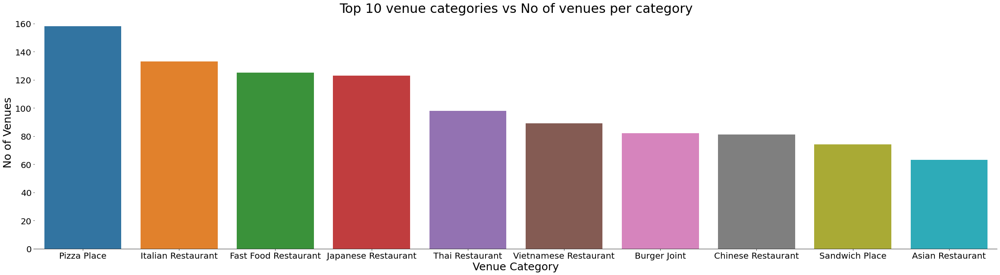

In [83]:
# Visualising the Top-10 Venue Categories Based on the number of locations within a category
category_count = pd.DataFrame(Melb_venues['Venue Category'].value_counts())
x=category_count.head(10)
ax= plt.figure(figsize=(40,10), frameon=False)

ax=sns.barplot( x=x.index, y='Venue Category' , data=x, linewidth=0 )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
#ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
plt.ylabel('No of Venues', fontsize=25)
plt.xlabel('Venue Category', fontsize=25)
plt.xticks(fontsize= 20)
plt.yticks(fontsize= 20)
plt.title('Top 10 venue categories vs No of venues per category', fontsize=30)

plt.show()

In [84]:
#Getting Top 10 Regions for Top-10 Categories
venue_cat_top= Melb_venues.groupby(['Venue Category', 'Suburb'])['Venue'].count().reset_index()
venue_cat_top = venue_cat_top.groupby('Venue Category').apply(lambda x:x.sort_values(['Venue'], ascending=False)).reset_index(drop=True)
venue_cat_top = venue_cat_top.groupby('Venue Category').head(10)
venue_cat_top

,Venue Category,Suburb,Venue
0,Afghan Restaurant,"'ALBION', 'GLENGALA', 'SUNSHINE', 'SUNSHINE NO...",1
1,Afghan Restaurant,"'AUBURN', 'HAWTHORN EAST'",1
2,Afghan Restaurant,"'BATMAN', 'COBURG', 'COBURG NORTH', 'MERLYNSTO...",1
3,Afghan Restaurant,"'BRUNSWICK', 'BRUNSWICK LOWER', 'BRUNSWICK NORTH'",1
4,African Restaurant,"'CLIFTON HILL', 'FITZROY NORTH'",2
5,African Restaurant,"'COLLINGWOOD', 'COLLINGWOOD NORTH'",1
6,African Restaurant,'FITZROY',1
7,African Restaurant,'ROYAL MELBOURNE HOSPITAL',1
8,African Restaurant,'WEST MELBOURNE',1
9,American Restaurant,'DONCASTER',1


In [85]:
top_cat=category_count.head(10)
top_cat_region= venue_cat_top[venue_cat_top['Venue Category'].isin(x.index)]
top_cat_region

,Venue Category,Suburb,Venue
14,Asian Restaurant,"'FOOTSCRAY', 'SEDDON', 'SEDDON WEST'",5
15,Asian Restaurant,'SOUTHBANK',4
16,Asian Restaurant,"'CHADSTONE', 'CHADSTONE CENTRE', 'HOLMESGLEN'",3
17,Asian Restaurant,"'SOUTH MELBOURNE', 'SOUTH MELBOURNE DC'",3
18,Asian Restaurant,'ABBOTSFORD',2
19,Asian Restaurant,'MONASH UNIVERSITY',2
20,Asian Restaurant,'FITZROY',2
21,Asian Restaurant,"'COLLINGWOOD', 'COLLINGWOOD NORTH'",2
22,Asian Restaurant,"'CLIFTON HILL', 'FITZROY NORTH'",2
23,Asian Restaurant,"'HUGHESDALE', 'HUNTINGDALE', 'OAKLEIGH', 'OAKL...",2


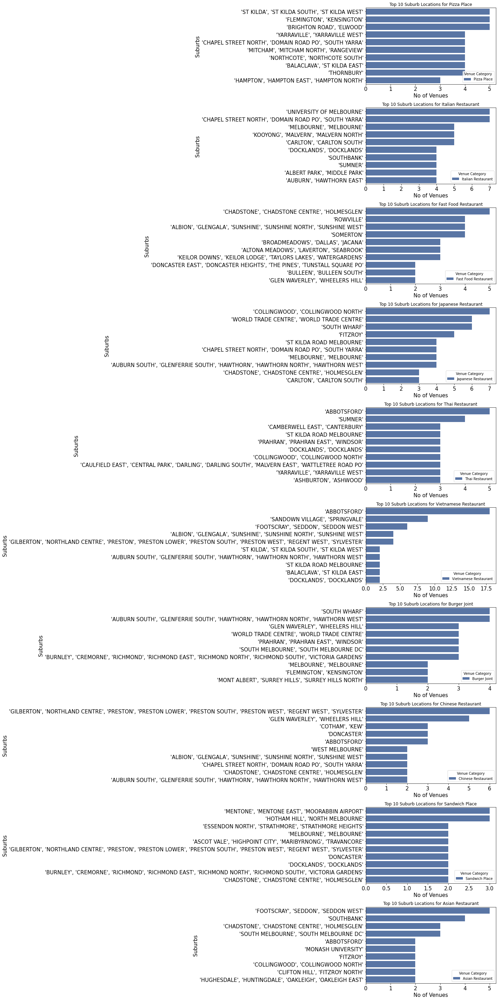

In [86]:
# Visualising top 10 suburbs containing the top 10 categories

fig, axes =plt.subplots(10, 1, figsize=(20
                                        ,40), sharex=False)
axes = axes.flatten()

for ax, val in zip(axes, top_cat.index):
    temp  = top_cat_region[top_cat_region['Venue Category']==val]
    pal = sns.color_palette("Blues", len(temp))
    #print(np.array(pal))
    sns.barplot(x=temp['Venue'], y=temp['Suburb'], data=temp, hue=temp['Venue Category'], ax=ax, palette="deep")
    ax.tick_params(axis='y', which='major', labelsize=15)
    ax.tick_params(axis='x', which='major', labelsize=15)
    ax.set_title("Top 10 Suburb Locations for {}".format(val))
    
    ax.set_xlabel("No of Venues", fontsize = 15)
    ax.set_ylabel("Suburbs", fontsize = 15)
   


fig.tight_layout()
plt.show();

## Analysing Each Neighbourhood 

In [87]:
# getting the value count for each suburb
region_venue_count=Melb_venues['Suburb'].value_counts().to_frame()
region_venue_count


,Suburb
'ABBOTSFORD',51
"'DOCKLANDS', 'DOCKLANDS'",51
'WEST MELBOURNE',50
"'COLLINGWOOD', 'COLLINGWOOD NORTH'",49
"'PRAHRAN', 'PRAHRAN EAST', 'WINDSOR'",49
"'AUBURN SOUTH', 'GLENFERRIE SOUTH', 'HAWTHORN', 'HAWTHORN NORTH', 'HAWTHORN WEST'",48
"'MELBOURNE', 'MELBOURNE'",47
"'WORLD TRADE CENTRE', 'WORLD TRADE CENTRE'",46
'FITZROY',46
"'CHAPEL STREET NORTH', 'DOMAIN ROAD PO', 'SOUTH YARRA'",44


In [88]:
# Dropping Regions with less than 5 recommended venues
Melb_venues= Melb_venues[Melb_venues.groupby('Suburb')[['Suburb','Suburb Latitude','Suburb Longitude',
                                                        'Venue', 'Venue Latitude', 
                                                        'Venue Longitude',
                                                        'Venue Category']].transform('count') > 4]
Melb_venues.dropna(inplace=True)
Melb_venues.shape


(1921, 7)

### Feature Engineering

In [89]:
# one hot encoding
melb_one_hot = pd.get_dummies(Melb_venues[['Venue Category']],  prefix="", prefix_sep="")

# add Suburb column back to dataframe
melb_one_hot['Suburb'] = Melb_venues['Suburb'] 


# move Region column to the first column
fixed_columns =  [melb_one_hot.columns[-1]] +  list(melb_one_hot.columns[:-1])
melb_one_hot = melb_one_hot[fixed_columns]

melb_one_hot.shape

(1921, 121)

In [90]:
melb_one_hot

,Suburb,Afghan Restaurant,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,Australian Restaurant,Austrian Restaurant,BBQ Joint,Bagel Shop,Beach Bar,Beer Bar,Beer Garden,Brazilian Restaurant,Breakfast Spot,Brewery,Bubble Tea Shop,Buffet,Burger Joint,Burmese Restaurant,Burrito Place,Cambodian Restaurant,Cantonese Restaurant,Chaat Place,Chinese Restaurant,Cocktail Bar,Comfort Food Restaurant,Creperie,Cretan Restaurant,Dim Sum Restaurant,Diner,Dive Bar,Dumpling Restaurant,Eastern European Restaurant,Egyptian Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Food Truck,French Restaurant,Fried Chicken Joint,Gastropub,Gay Bar,German Restaurant,Greek Restaurant,Halal Restaurant,Himalayan Restaurant,Hookah Bar,Hot Dog Joint,Hotel Bar,Hungarian Restaurant,Indian Chinese Restaurant,Indian Restaurant,Indonesian Restaurant,Iraqi Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewish Restaurant,Karaoke Bar,Kebab Restaurant,Korean BBQ Restaurant,Korean Restaurant,Latin American Restaurant,Lebanese Restaurant,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,Molecular Gastronomy Restaurant,Moroccan Restaurant,Nightclub,Noodle House,Pakistani Restaurant,Peking Duck Restaurant,Persian Restaurant,Pie Shop,Pizza Place,Polish Restaurant,Portuguese Restaurant,Ramen Restaurant,Rock Club,Romanian Restaurant,Rooftop Bar,Russian Restaurant,Sake Bar,Salad Place,Sandwich Place,Scandinavian Restaurant,Seafood Restaurant,Snack Place,Soba Restaurant,Social Club,South American Restaurant,South Indian Restaurant,Southern / Soul Food Restaurant,Souvlaki Shop,Spanish Restaurant,Speakeasy,Sports Bar,Sri Lankan Restaurant,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Tea Room,Thai Restaurant,Tibetan Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Whisky Bar,Wine Bar,Xinjiang Restaurant,Yunnan Restaurant
56,"'KEILOR DOWNS', 'KEILOR LODGE', 'TAYLORS LAKES...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
57,"'KEILOR DOWNS', 'KEILOR LODGE', 'TAYLORS LAKES...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
63,"'KEILOR DOWNS', 'KEILOR LODGE', 'TAYLORS LAKES...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
64,"'KEILOR DOWNS', 'KEILOR LODGE', 'TAYLORS LAKES...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
70,"'KEILOR DOWNS', 'KEILOR LODGE', 'TAYLORS LAKES...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
71,"'KEILOR DOWNS', 'KEILOR LODGE', 'TAYLORS LAKES...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
72,"'KEILOR DOWNS', 'KEILOR LODGE', 'TAYLORS LAKES...",0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [458]:
# Getting the descriptive statistics for the dataframe
melb_one_hot.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Afghan Restaurant,1921.0,0.002082,0.045596,0.0,0.0,0.0,0.0,1.0
African Restaurant,1921.0,0.003123,0.055814,0.0,0.0,0.0,0.0,1.0
American Restaurant,1921.0,0.001041,0.032258,0.0,0.0,0.0,0.0,1.0
Arepa Restaurant,1921.0,0.000521,0.022816,0.0,0.0,0.0,0.0,1.0
Argentinian Restaurant,1921.0,0.000521,0.022816,0.0,0.0,0.0,0.0,1.0
Asian Restaurant,1921.0,0.030193,0.171162,0.0,0.0,0.0,0.0,1.0
Australian Restaurant,1921.0,0.026028,0.159260,0.0,0.0,0.0,0.0,1.0
Austrian Restaurant,1921.0,0.000521,0.022816,0.0,0.0,0.0,0.0,1.0
BBQ Joint,1921.0,0.009891,0.098985,0.0,0.0,0.0,0.0,1.0
Bagel Shop,1921.0,0.007288,0.085080,0.0,0.0,0.0,0.0,1.0


In [91]:
# Grouping the dataframe by the suburb column and taking the sum of the occurences of each venue category in each suburb
melb_grp = melb_one_hot.groupby('Suburb').sum().reset_index()
melb_grp.set_index('Suburb', inplace=True)


In [92]:
melb_grp.shape

(99, 120)

Analysing the distrbution of some of the columns in the dataframe

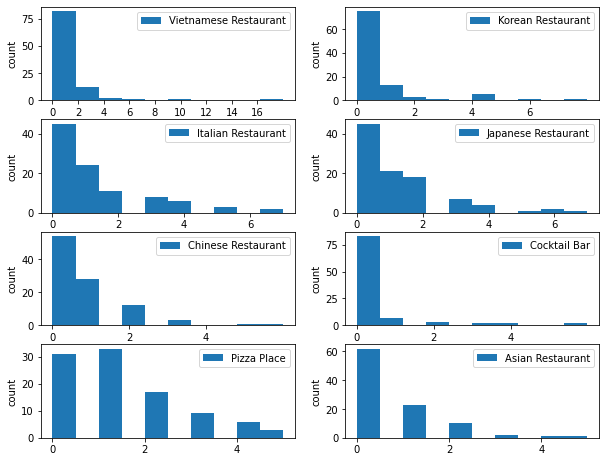

In [93]:
#Visualising the distribution of some of the columns  

fig, axes = plt.subplots(4, 2, figsize=(10,10), sharex= False)
axes = axes.flatten()
col_list= ['Vietnamese Restaurant', 'Korean Restaurant', 'Italian Restaurant', 'Japanese Restaurant', 'Chinese Restaurant', 'Cocktail Bar', 'Pizza Place',
          'Asian Restaurant']

for ax, col, i  in zip(axes, col_list, range(1, len(col_list)+1)):
    temp = melb_grp[col]
    plt.subplot(5,2,i)
    plt.hist(temp, label =col_list[i-1] )
    plt.xticks(np.arange(0, temp.max(),2))
    plt.legend(loc="upper right")
    plt.ylabel('count')
    
plt.show()
    

    



                      

In [95]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [96]:
# Creating a dataframe to get top 5 food venue categories in each suburb

num_top_venues = 5

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Suburb']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Suburb'] = melb_grp.index

for ind in np.arange(melb_grp.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(melb_grp.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted

,Suburb,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,'ABBOTSFORD',Vietnamese Restaurant,Thai Restaurant,Brewery,Vegetarian / Vegan Restaurant,Korean Restaurant
1,"'ALBANVALE', 'KEALBA', 'KINGS PARK', 'ST ALBANS'",Vietnamese Restaurant,Asian Restaurant,Portuguese Restaurant,Fast Food Restaurant,Noodle House
2,"'ALBERT PARK', 'MIDDLE PARK'",Italian Restaurant,Asian Restaurant,Breakfast Spot,Burger Joint,Wine Bar
3,"'ALBION', 'GLENGALA', 'SUNSHINE', 'SUNSHINE NO...",Fast Food Restaurant,Vietnamese Restaurant,Chinese Restaurant,Pizza Place,Malay Restaurant
4,"'ALPHINGTON', 'FAIRFIELD'",Greek Restaurant,Lebanese Restaurant,Fast Food Restaurant,Breakfast Spot,Pizza Place
5,"'ARMADALE', 'ARMADALE NORTH'",Italian Restaurant,Japanese Restaurant,Pizza Place,Fast Food Restaurant,Chinese Restaurant
6,"'ASCOT VALE', 'HIGHPOINT CITY', 'MARIBYRNONG',...",Burger Joint,Sandwich Place,Fast Food Restaurant,Mexican Restaurant,Chinese Restaurant
7,"'ASHBURTON', 'ASHWOOD'",Korean Restaurant,Thai Restaurant,Fast Food Restaurant,Chinese Restaurant,Sandwich Place
8,"'AUBURN SOUTH', 'GLENFERRIE SOUTH', 'HAWTHORN'...",Japanese Restaurant,Burger Joint,Italian Restaurant,Malay Restaurant,Chinese Restaurant
9,"'AUBURN', 'HAWTHORN EAST'",Italian Restaurant,Pizza Place,Thai Restaurant,Asian Restaurant,Cretan Restaurant


### Feature Scaling

In [99]:
# scaling the data to a common scale 
scaler = StandardScaler()
melb_scale = scaler.fit_transform(melb_grp)
melb_scale


array([[-0.20519567, -0.21821789, -0.14359163, ..., -0.3928371 ,
        -0.10101525, -0.1767767 ],
       [-0.20519567, -0.21821789, -0.14359163, ..., -0.3928371 ,
        -0.10101525, -0.1767767 ],
       [-0.20519567, -0.21821789, -0.14359163, ...,  0.90352533,
        -0.10101525, -0.1767767 ],
       ...,
       [-0.20519567,  3.3823773 , -0.14359163, ..., -0.3928371 ,
        -0.10101525, -0.1767767 ],
       [-0.20519567, -0.21821789, -0.14359163, ..., -0.3928371 ,
        -0.10101525, -0.1767767 ],
       [-0.20519567, -0.21821789, -0.14359163, ...,  0.90352533,
        -0.10101525, -0.1767767 ]])

## Cluster Analysis

Choosing the optimal number of clusters

### Elbow Method

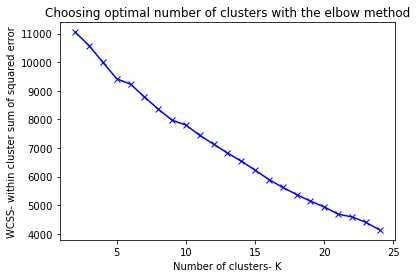

In [100]:
wcss=[]

#this loop will fit the k-means algorithm to our data and 
#second we will compute the within cluster sum of squares and #appended to our wcss list.

for i in range(2,25): 
     kmeans = KMeans(n_clusters=i, init ='k-means++', n_init=20, max_iter=300, random_state=42)
        
#i above is between 2-25 numbers. init parameter is selected a K-means++ 
#max_iter parameter the maximum number of iterations there can be to 
#find the final clusters when the K-meands algorithm is running. A default value of 300 is used
#the next parameter is n_init which is the number of times the #K_means algorithm will be run with
#different initial centroid. Using default values of 10.

     kmeans.fit(melb_scale)
#kmeans algorithm fits to the X dataset
     wcss.append(kmeans.inertia_)
#kmeans inertia_ attribute is:  Sum of squared distances of samples #to their closest cluster center.
#4.Plot the elbow graph
plt.plot(range(2,25),wcss, 'bx-')
plt.title('Choosing optimal number of clusters with the elbow method')
plt.xlabel('Number of clusters- K')
plt.ylabel('WCSS- within cluster sum of squared error')
plt.show()

### The Silhouette Method

2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 

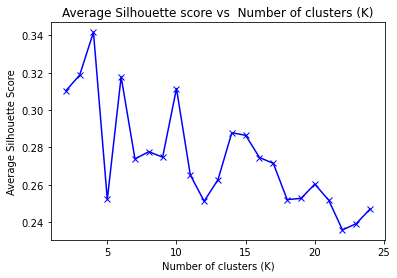

In [101]:
from sklearn.metrics import silhouette_score

sil = []
K_sil = range(2,25)
# minimum 2 clusters required, to define dissimilarity
for k in K_sil:
    print(k, end=' ')
    kmeans = KMeans(init="k-means++", n_clusters=k,n_init=50, max_iter=300, random_state=42).fit(melb_scale)
    labels = kmeans.labels_
    sil.append(silhouette_score(melb_scale, labels, metric = 'euclidean'))

plt.plot(K_sil, sil, 'bx-')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Average Silhouette Score')
plt.title('Average Silhouette score vs  Number of clusters (K)')
plt.show()


In [102]:
from collections import Counter # count occurrences  
# set number of clusters
kclusters = 4

# run k-means clustering
kmeans = KMeans(init="k-means++",n_init=50, max_iter=300, random_state=42,  n_clusters=kclusters).fit(melb_grp)

print(Counter(kmeans.labels_))


Counter({3: 55, 0: 29, 2: 12, 1: 3})


In [104]:
kmeans.labels_


array([1, 3, 0, 3, 3, 0, 3, 3, 0, 0, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3,
       3, 0, 3, 3, 3, 3, 0, 3, 3, 0, 0, 3, 3, 3, 0, 2, 3, 0, 3, 2, 3, 0,
       2, 3, 2, 3, 3, 0, 3, 3, 2, 0, 1, 3, 0, 3, 0, 3, 3, 3, 3, 0, 3, 3,
       3, 3, 0, 3, 2, 3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 0, 3, 2, 1, 3, 0,
       2, 2, 0, 0, 0, 3, 0, 2, 2, 2, 0], dtype=int32)

In [105]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)


In [106]:
#removing the list type representation of the Suburb Column
neighborhoods_venues_sorted['Suburb'] = neighborhoods_venues_sorted['Suburb'].apply(lambda x: x.strip(']['))
neighborhoods_venues_sorted.shape

(99, 7)

In [107]:
melb_merged = melb_post_code_grp
melb_merged['Suburb'] = melb_merged['Suburb'].apply(lambda x: str(x).strip(']['))

neighborhoods_venues_sorted.loc[48, 'Suburb']="'MELBOURNE'"


In [108]:
melb_merged = melb_merged.merge(neighborhoods_venues_sorted, left_on='Suburb', right_on = 'Suburb',
                                      how='inner')


melb_merged.shape

(99, 9)

In [109]:
melb_merged.head()

,Long,Lat,Suburb,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,144.765920,-38.365017,'MELBOURNE',3,Chinese Restaurant,Sandwich Place,Bubble Tea Shop,Korean Restaurant,Salad Place
1,144.766873,-37.700454,"'KEILOR DOWNS', 'KEILOR LODGE', 'TAYLORS LAKES...",3,Fast Food Restaurant,Burger Joint,Steakhouse,Vietnamese Restaurant,Portuguese Restaurant
2,144.770641,-37.782720,"'BURNSIDE', 'CAIRNLEA', 'CAROLINE SPRINGS', 'D...",3,Sandwich Place,Portuguese Restaurant,Chinese Restaurant,Pizza Place,Fast Food Restaurant
3,144.796693,-37.743361,"'ALBANVALE', 'KEALBA', 'KINGS PARK', 'ST ALBANS'",3,Vietnamese Restaurant,Asian Restaurant,Portuguese Restaurant,Fast Food Restaurant,Noodle House
4,144.829945,-37.777204,"'ALBION', 'GLENGALA', 'SUNSHINE', 'SUNSHINE NO...",3,Fast Food Restaurant,Vietnamese Restaurant,Chinese Restaurant,Pizza Place,Malay Restaurant


In [110]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.gist_rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(melb_merged['Lat'], melb_merged['Long'], melb_merged['Suburb'], melb_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters
        )
       
map_clusters

In [117]:
melb_merged.columns
col_indices = [4,5,6,7,8]
col_required=[(melb_merged.columns[val]) for val in col_indices]
col_required

['1st Most Common Venue',
 '2nd Most Common Venue',
 '3rd Most Common Venue',
 '4th Most Common Venue',
 '5th Most Common Venue']

In [111]:
!pip install wordcloud 
from wordcloud import WordCloud, STOPWORDS

     |████████████████████████████████| 366 kB 12.2 MB/s eta 0:00:01


In [112]:
# function to remove special characters '' from the suburb column, for clean presenation in the wordcloud 
def clean_list(list_input):
    for i in  range(0, len(list_input)):
     
        list_input[i] = list_input[i].split(' ')
        list_input[i] = ' '.join(word.strip("''") for word in list_input[i] ) 
        list_input[i] = list_input[i].strip(' ').replace(' ', '_')
    
    return list_input

In [113]:
# function to generate word cloud for subrbs within each cluster
def generate_word_cloud (df, cluster_num):
    
    #selecting the data for the required cluster
    df_cluster = df[df['Cluster Labels']==cluster_num]
    
    #cleaning the list of suburbs and removing special characters such as'' for the wordcloud plot 
    df_cluster['Suburb'] =  df_cluster['Suburb'].apply(lambda x: x.split(',') )
    
    #Adding a '_' inplace of space between the name of a suburb so that the suburb name is treated as single word in wordcloud
    # Eg: Port Melbourne ------> Port_Melbourne 
    df_cluster['Suburb'] =  df_cluster['Suburb'].apply(lambda x:  clean_list(x))
    
    
    #concatinating all the names of a suburb into a string
    subrub_names = ' '.join(word for char in df_cluster['Suburb'] for word in char)
    
    
    #plotting the wordcloud 
    wordcloud = WordCloud(width = 2000, height = 2000).generate(subrub_names)
    plt.figure(figsize= (10,10))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.show()
    
    
    
    

In [114]:
#function to plot top 5 venue categories in each cluster
def plot_top_cat(df, cluster_num, col_list):
    
    cluster_df= df[df['Cluster Labels']==cluster_num]
    top_venue_cat=pd.DataFrame()
    temp = pd.DataFrame()
    
    for col in col_list:
        temp=cluster_df[col].value_counts().to_frame()
        top_venue_cat=pd.concat([top_venue_cat,temp], axis=1)


    top_venue_cat.fillna(0, inplace=True)
    top_venue_cat['sum'] = top_venue_cat.apply(lambda x: x.sum(), axis = 1)

    top_venue_cat = top_venue_cat.sort_values('sum', ascending =False)
    top_venue_cat_5 =top_venue_cat.head()
    
    
    plt.figure(figsize =(15,10))

    ax= sns.barplot (x = top_venue_cat_5.index, y = 'sum', data =top_venue_cat_5 )
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(True)
    plt.yticks(np.arange(0, top_venue_cat_5['sum'].max()+1, 2), fontsize =15)
    plt.xticks(fontsize =15)
    plt.xlabel('Venue Category', fontsize =18)
    plt.ylabel('Count of Venues', fontsize =18)
    plt.title('Top 5 venue categories for Cluster:{}'.format(cluster_num+1), fontsize = 18)
    plt.show()


/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/ipykernel/__main__.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/ipykernel/__main__.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


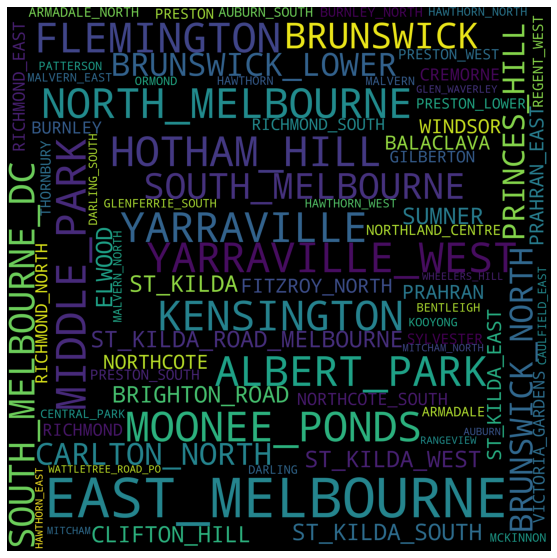

In [115]:
# Cluster 1 wordcloud
generate_word_cloud(melb_merged, 0)

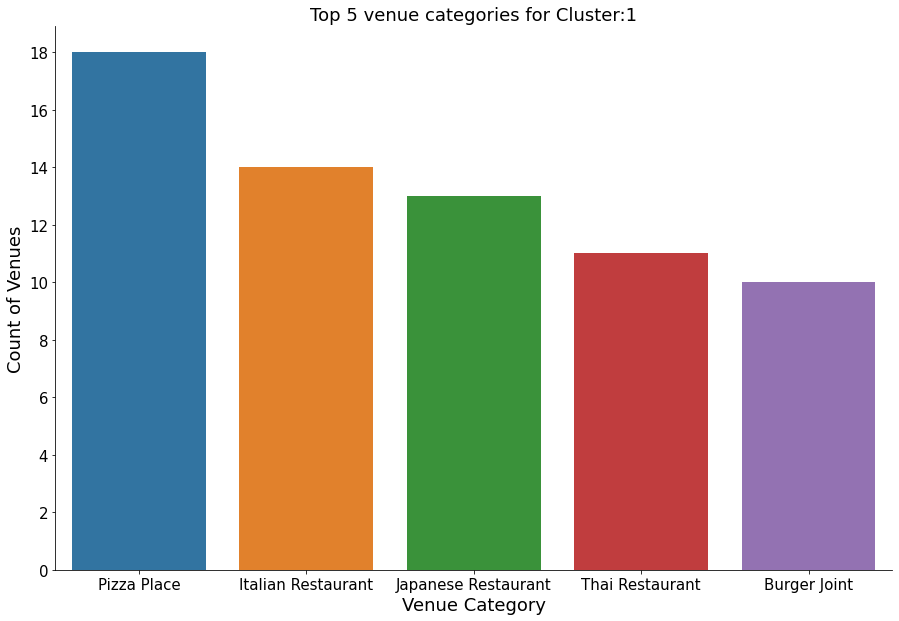

In [118]:
# Top 5 venue categories in 1st cluster
plot_top_cat(melb_merged, 0, col_required)

/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/ipykernel/__main__.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/ipykernel/__main__.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


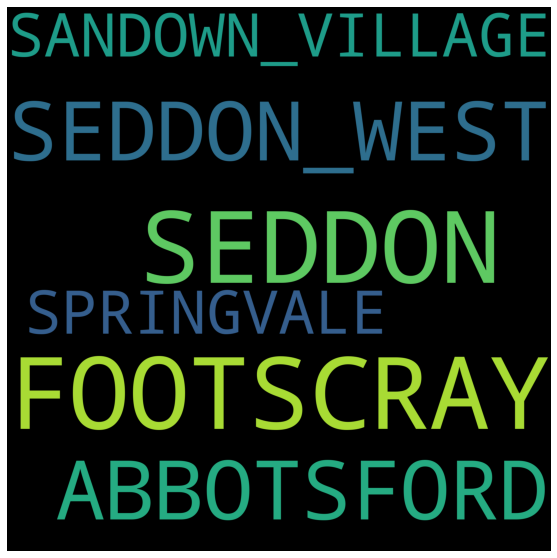

In [119]:
# Cluster 2 wordcloud
generate_word_cloud(melb_merged, 1)

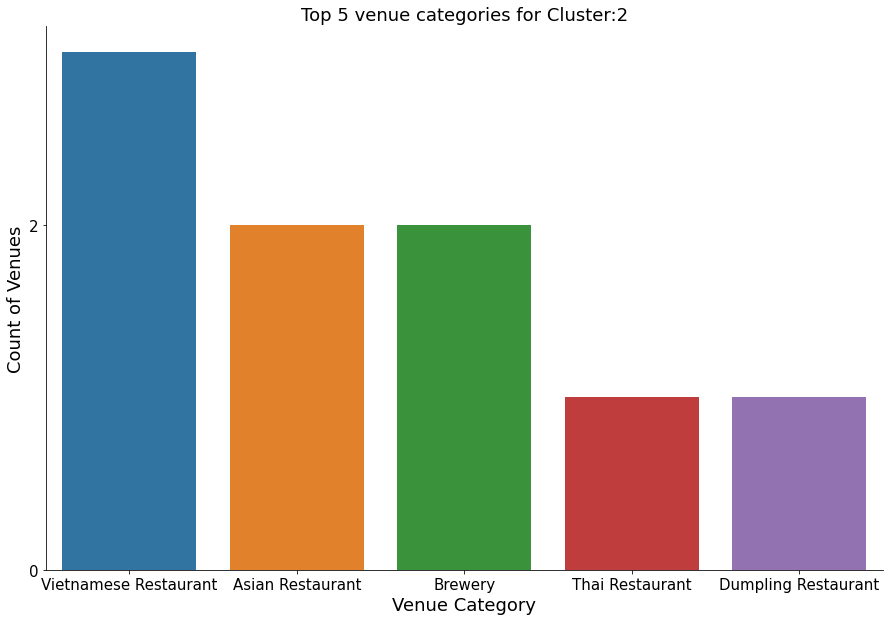

In [120]:
# Top 5 venue categories in Cluster 2
plot_top_cat(melb_merged, 1, col_required)

/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/ipykernel/__main__.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/ipykernel/__main__.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


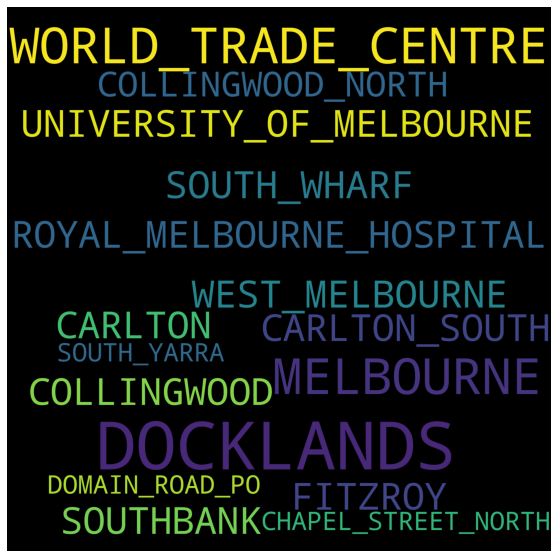

In [121]:
# Cluster 3 wordcloud
generate_word_cloud(melb_merged, 2)

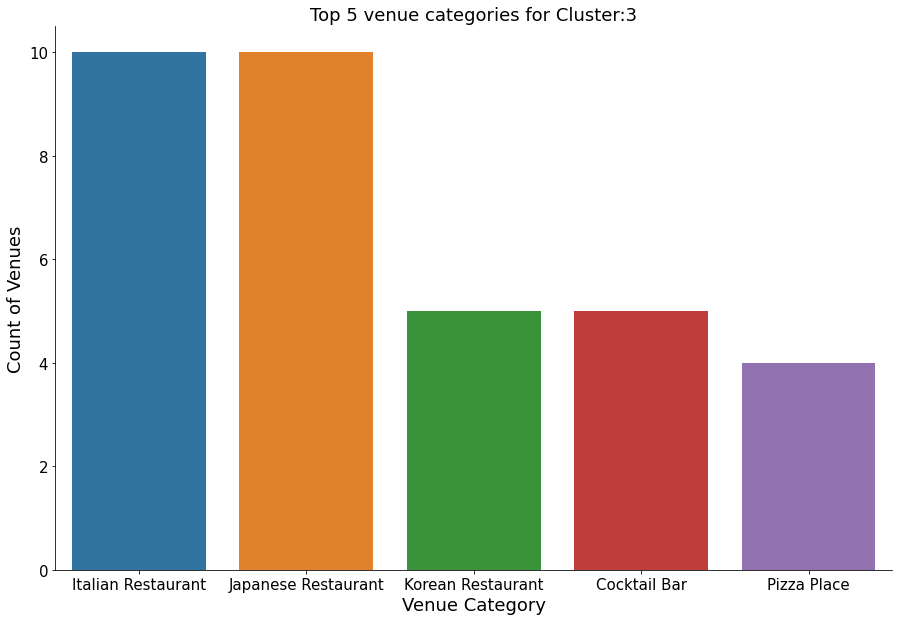

In [122]:
# Top 5 venue categories in cluster 3
plot_top_cat(melb_merged, 2, col_required)

/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/ipykernel/__main__.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/ipykernel/__main__.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


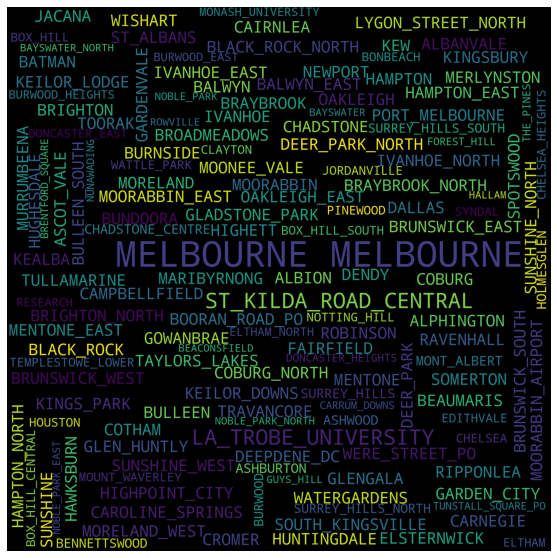

In [123]:
# Cluster 4 wordcloud
generate_word_cloud(melb_merged, 3)

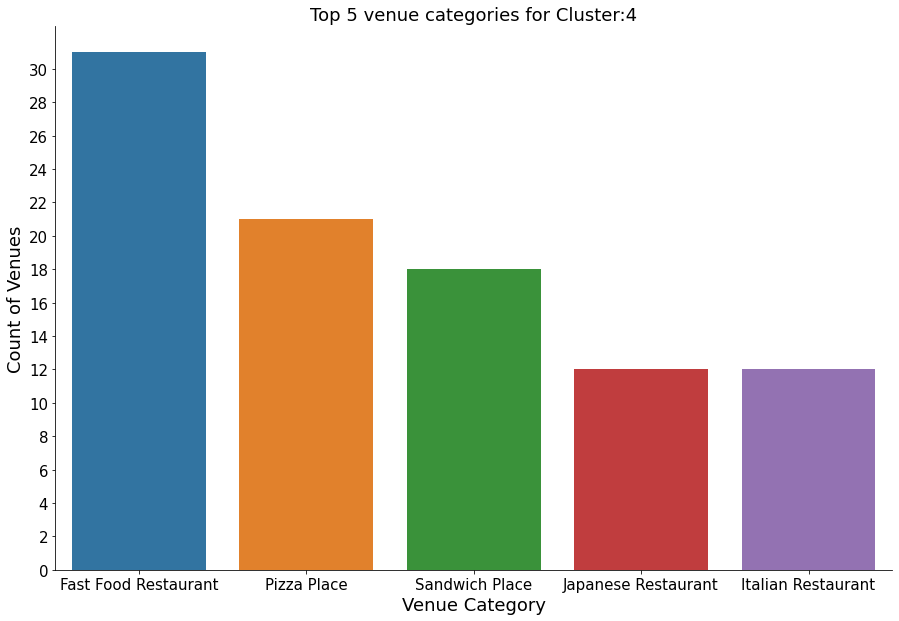

In [124]:
# Top 5 Venue categories for cluster 4
plot_top_cat(melb_merged, 3, col_required)